# Processing raw landsat scenes 

In [21]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt

from PIL import Image 
import rasterio as rio
import random
import matplotlib as mpl
import tifffile as tiff

import json
import os
import cv2

# Reload utils
import importlib
import utils
importlib.reload(utils)

base_path = '../data/'

# Select test images

In [3]:
df_labels = pd.read_csv(base_path + 'label_scenes.csv')

print(df_labels.shape)
df_labels.head()

(100, 16)


,year,altitude_category,id,path,row,satellite,cloud_cover,tier,utm_zone,lat,lon,date,time,month,altitude,task
0,2017,high,LC08_L2SP_205023_20170505_20200904_02_T1,205,23,8,2,1,30,53.10266,-5.02235,2017-05-05,2017-05-05 11:15:45.516137,5,51.383728,1
1,2019,high,LC08_L2SP_205023_20190628_20200827_02_T1,205,23,8,9,1,30,53.10258,-5.04996,2019-06-28,2019-06-28 11:16:20.726652,6,57.582579,2
2,2020,high,LC08_L2SP_205023_20200529_20200820_02_T1,205,23,8,2,1,30,53.10270,-5.03278,2020-05-29,2020-05-29 11:15:55.184734,5,56.487645,3
3,2015,low,LC08_L2SP_205024_20150124_20200910_02_T1,205,24,8,4,1,30,51.69320,-5.72348,2015-01-24,2015-01-24 11:16:47.907172,1,17.108840,4
4,2015,high,LC08_L2SP_205024_20150719_20200909_02_T1,205,24,8,5,1,30,51.69345,-5.70362,2015-07-19,2015-07-19 11:16:25.474865,7,56.077386,5


In [5]:
#create a new column with the path and row combined
df_labels['tile'] = df_labels['path'].astype(str) + '_' + df_labels['row'].astype(str)

# get list of unique tile values
tiles = df_labels['tile'].unique()
print(len(tiles))

# get list of ids split into a group based on path and row numbers
tile_ids = {}
for tile in tiles:
    tile_ids[tile] = df_labels[df_labels['tile'] == tile]['id'].values

print(tile_ids)

11
{'205_23': array(['LC08_L2SP_205023_20170505_20200904_02_T1',
       'LC08_L2SP_205023_20190628_20200827_02_T1',
       'LC08_L2SP_205023_20200529_20200820_02_T1',
       'LT05_L2SP_205023_19870417_20201014_02_T1',
       'LT05_L2SP_205023_19900714_20200916_02_T1',
       'LT05_L2SP_205023_19920516_20200915_02_T1',
       'LT05_L2SP_205023_19950626_20200912_02_T1',
       'LT05_L2SP_205023_19970530_20211128_02_T1',
       'LT05_L2SP_205023_20050402_20200902_02_T1',
       'LT05_L2SP_205023_20060405_20200901_02_T1',
       'LT05_L2SP_205023_20100211_20200824_02_T1'], dtype=object), '205_24': array(['LC08_L2SP_205024_20150124_20200910_02_T1',
       'LC08_L2SP_205024_20150719_20200909_02_T1',
       'LC08_L2SP_205024_20160331_20200907_02_T1',
       'LC08_L2SP_205024_20190204_20200829_02_T1',
       'LC08_L2SP_205024_20190324_20200829_02_T1',
       'LC08_L2SP_205024_20200411_20200822_02_T1',
       'LC08_L2SP_205024_20210719_20210729_02_T1',
       'LC08_L2SP_205024_20230420_20230429

In [12]:
QA = utils.get_QA(df_labels['id'][0])

np.sum(QA == 1)

25232013

In [42]:
def check_crop(tile,mask,QA,x,y,size=256):

    """check if a crop is valid based on the percentage of water pixels and missing data"""

    # Ensure test image taken from Ireland
    if tile in ["205_23","205_24"] and x > 4000:
        return False
    elif tile in ["206_22"] and x > 6000:
        return False

    mask_crop = mask[y:y+size,x:x+size]
    QA_crop = QA[y:y+size,x:x+size]
    
    # check if there is missing data
    miss_data = np.sum(QA_crop == 1)
    if miss_data > 0:
        return False
    
    # check if percentage of water is between 40% and 60%
    per_water = np.sum(mask_crop) / (size*size)
    if per_water < 0.4 or per_water > 0.6:
        return False
    
    return True

def get_valid_crops(tile,steps=10):
    """Returns a list of valid crops for a given tile"""

    # step 1: get pixel coordinates of valid crops for first id
    id = tile_ids[tile][0]
    
    potential_crops = []
    mask = utils.get_mask(id)
    QA = utils.get_QA(id)

    for x in range(0,QA.shape[0]-256,steps):
        for y in range(0,QA.shape[1]-256,steps):
            if check_crop(tile,mask,QA,x,y):
                potential_crops.append((x,y))

    # step 2: get utm coordinates of potential crops
    geo = utils.get_geolocation(id)
    potential_crops_utm = []
    for x,y in potential_crops:
        utmx,utmy = geo.xy(y,x)
        potential_crops_utm.append((utmx,utmy))
    
    # step 3: check if the same coordinates are valid for all ids for tile
    for id in tile_ids[tile][1:]:

        mask = utils.get_mask(id)
        QA = utils.get_QA(id)
        geo = utils.get_geolocation(id)

        for utmx,utmy in potential_crops_utm:
            y,x = geo.index(utmx,utmy)
            if not check_crop(tile,mask,QA,x,y):
                # if not valid, remove from list
                potential_crops_utm.remove((utmx,utmy))

    return potential_crops_utm


def display_crop(id,x,y,size=256,resize=True):
    """Display a 256x256 patch with given constraints"""
    
    RGB = utils.get_rgb(id)
    
    # Crop RGB and mask
    RGB_crop = RGB.copy()[y:y+size,x:x+size,:]

    #add square at x,y coordiantes to RGB and mask
    RGB = cv2.rectangle(RGB,(x,y),(x+size,y+size),(255,0,0),20)

    # resize to 1th
    if resize:
        RGB = cv2.resize(RGB, (0,0), fx=0.1, fy=0.1)

    fig, ax = plt.subplots(1,2,figsize=(20,20))
    ax[0].imshow(RGB)
    ax[0].set_title(id,fontsize=18)
    ax[0].axis('off')

    ax[1].imshow(RGB_crop)
    ax[1].axis('off')

In [65]:
valid_crops = {}

# get valid crops for each tile
for tile in tiles:

    crops = get_valid_crops(tile,steps=10)
    valid_crops[tile] = crops

    print(tile,len(crops))

# save valid crops as json
with open(base_path + 'valid_test_crops.json', 'w') as fp:
    json.dump(valid_crops, fp)

205_23 1000
205_24 333
206_22 4400
206_24 3097
207_22 4381
207_23 770
207_24 4920
208_23 6894
208_24 6178
208_22 4142
206_23 2737


1210 5440


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1830 1960


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


3180 6370


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1710 3470


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2850 1360


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


740 4990


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


5060 3410


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


3570 1510


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


5940 4570


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1940 4800


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


5150 5340


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


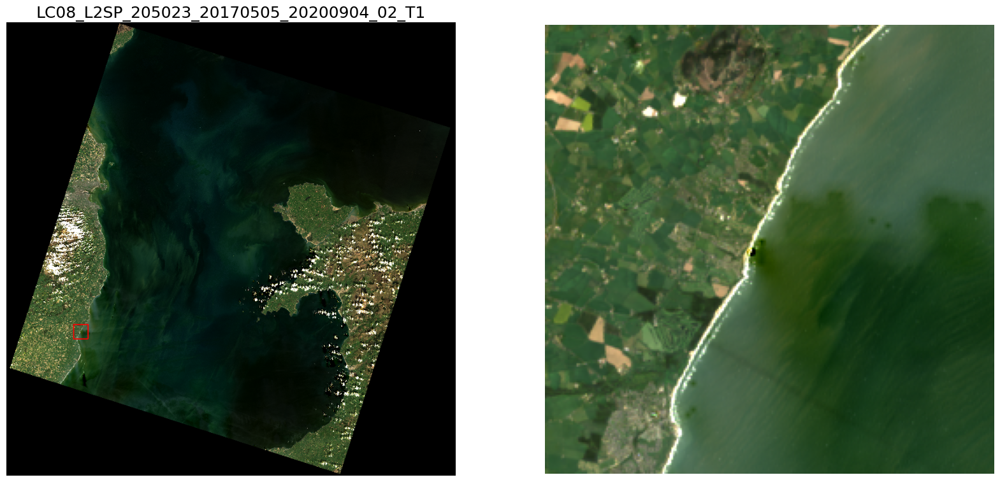

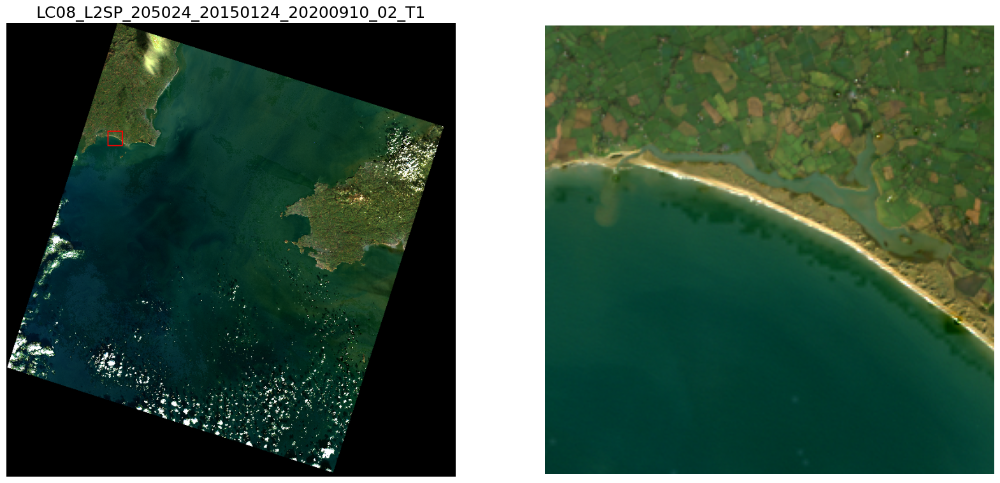

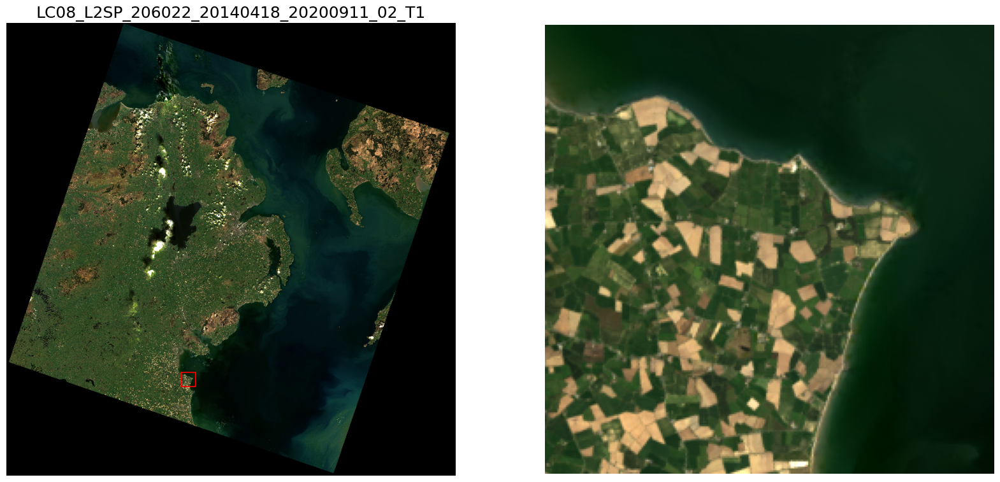

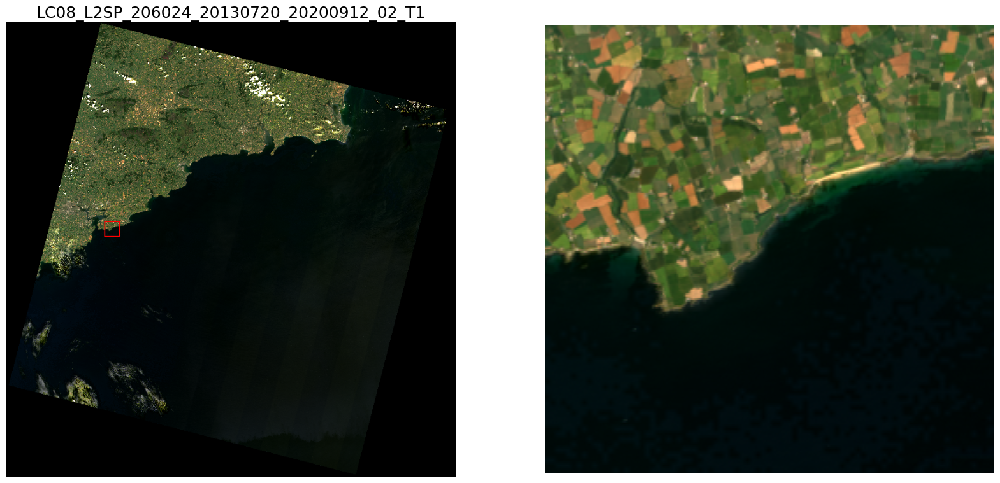

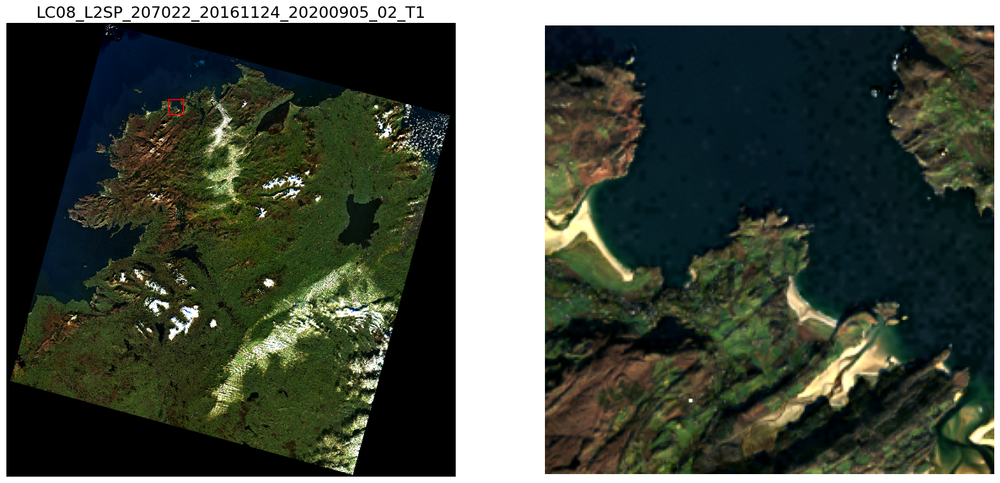

...

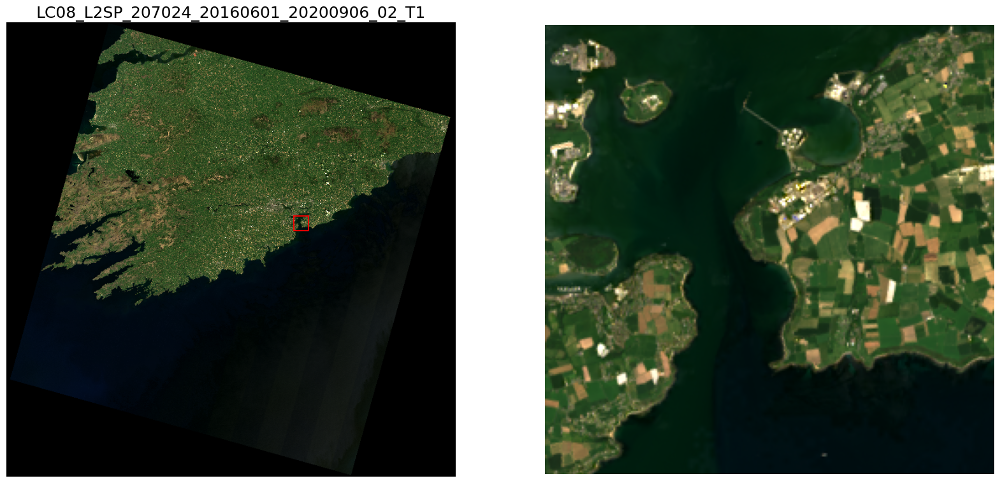

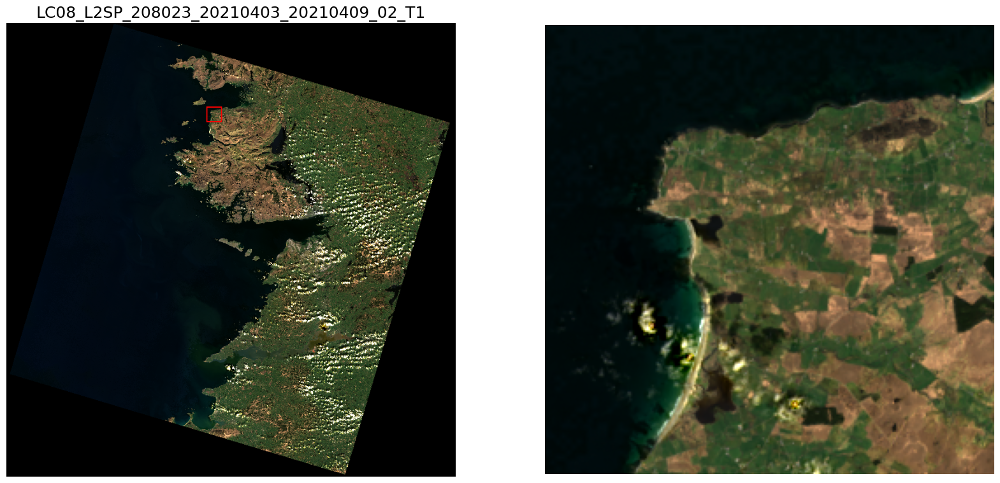

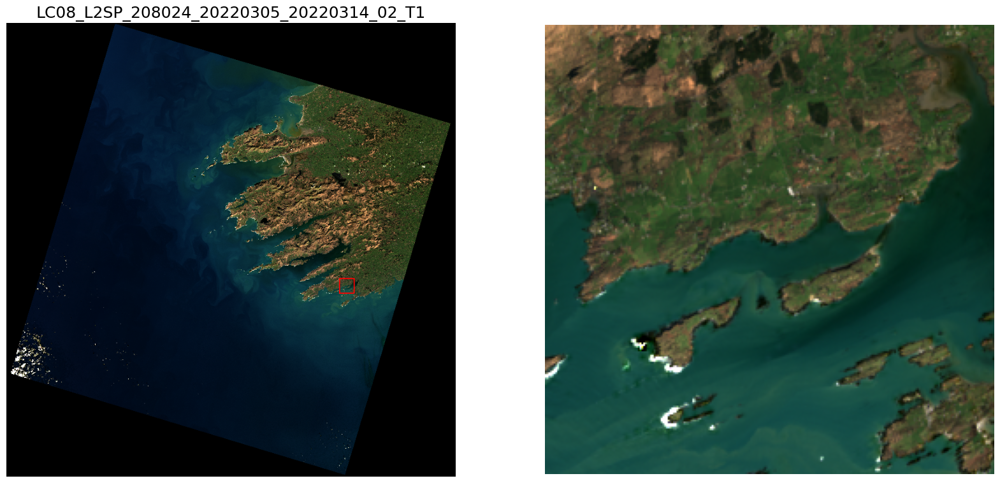

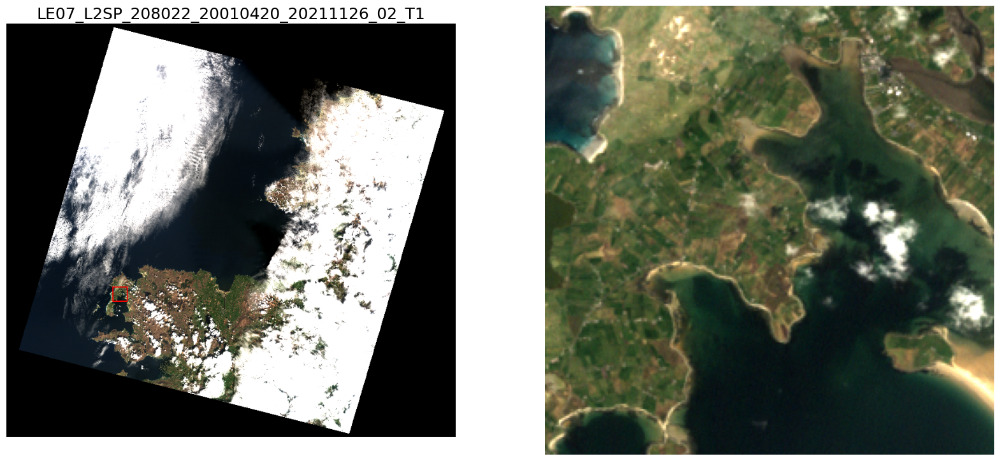

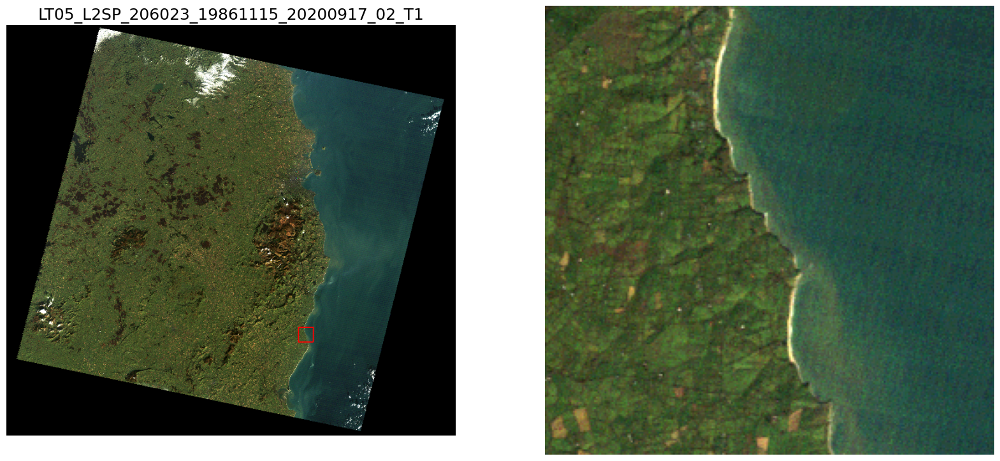

In [66]:
valid_crops = json.load(open(base_path + 'valid_test_crops.json'))

final_crop = {}

for tile in tiles:
    
    id = tile_ids[tile][0]
    geo = utils.get_geolocation(id)

    # get random crop from list of valid crops
    utmx,utmy = random.choice(valid_crops[tile])
    final_crop[tile] = (utmx,utmy)

    # display crop
    y,x = geo.index(utmx,utmy)
    print(x,y)
    display_crop(id,x,y)

# save final crops as json
with open(base_path + 'final_test_crops.json', 'w') as fp:
    json.dump(final_crop, fp)

In [67]:
final_crop = json.load(open(base_path + 'final_test_crops.json'))


# Create test set from final crops
for tile in tiles:
    utmx,utmy = final_crop[tile]

    ids = tile_ids[tile]
    for id in ids:
        geo = utils.get_geolocation(id)
        y,x = geo.index(utmx,utmy)

        stack = tiff.imread(base_path + 'stacked/' + id + '.TIF')
        stack = np.array(stack)

        stack_crop = stack[y:y+256,x:x+256,:]

        # save crop
        np.save(base_path + 'test/' + id + '.npy',stack_crop)

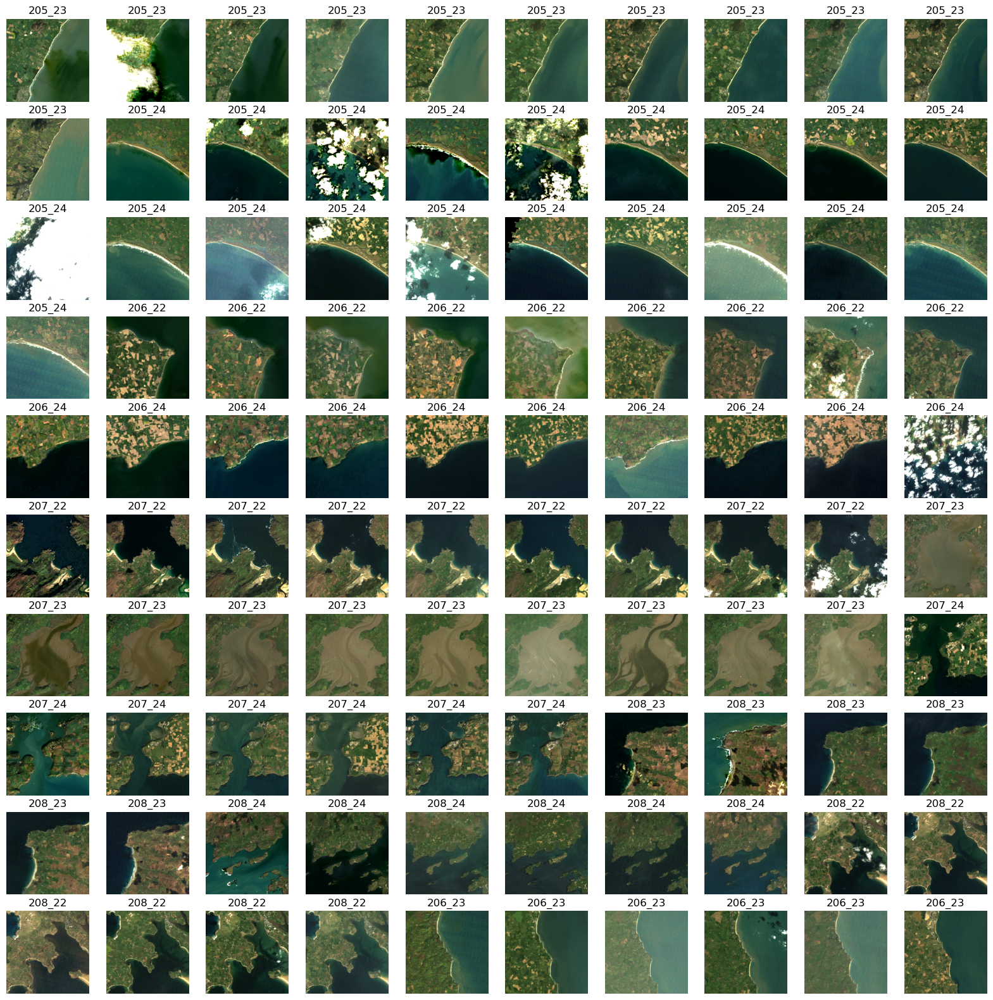

In [68]:
# Display test set
fig,ax = plt.subplots(10,10,figsize=(20,20))

i = 0
for tile in tiles:
    for id in tile_ids[tile]:

        test = np.load(base_path + 'test/' + id + '.npy')
        
        rgb = test[:,:,[2,1,0]]
        rgb = rgb.astype(np.float32)
        rgb = np.clip(rgb*0.0000275-0.2, 0, 1)
        rgb = np.clip(rgb,0,0.2)/0.2

        ax[i//10,i%10].imshow(rgb)
        ax[i//10,i%10].axis('off')

        tile = df_labels[df_labels['id'] == id]['tile'].values[0]

        #set title
        ax[i//10,i%10].set_title(tile,fontsize=12)

        i += 1

# Get rough training images


In [ ]:
for 

# Select fine-tune training images

# archive

In [ ]:
def random_test_crop(mask,RGB,size=256):
    """Randomly crop a 256x256 patch with given constraints"""

    invalid = True
    while invalid:
        # Get random x,y coordinates
        x = np.random.randint(0,mask.shape[0]-size)
        y = np.random.randint(0,mask.shape[1]-size)

        mask_crop = mask[x:x+size,y:y+size]
        rgb_crop = RGB[x:x+size,y:y+size]
        
        # check if percentage of water is between 40% and 60%
        per_water = np.sum(mask_crop) / (size*size)
        miss_data = np.sum(rgb_crop == [0,0,0])

        invalid = per_water < 0.4 or per_water > 0.6 or miss_data > 0
         
    return x,y